# Bird hotspots

In [1]:
import re, os, sys, pickle, pickle
from pathlib import Path
import numpy as np
import pandas as pd
import ete3
np.random.seed(7)

Plotting setup:

In [2]:
%matplotlib inline

# Make inline plots vector graphics instead of raster graphics
from IPython.display import set_matplotlib_formats
#set_matplotlib_formats('pdf', 'svg')
set_matplotlib_formats('retina', 'png')

import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib.patches import Rectangle
from matplotlib.lines import Line2D

#matplotlib.rcParams['figure.figsize'] = (20.0, 10.0)

import mpld3

import seaborn as sns
sns.set() # sets seaborn default "prettyness:
sns.set_style("whitegrid")
sns.set_context("paper")

# lowess for plotting
from statsmodels.nonparametric.smoothers_lowess import lowess

Ignore deprecation warnings from mainly seaborn:

In [3]:
# silence deprecation warnings (lots from seaborn)
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings("ignore", category=np.VisibleDeprecationWarning)
warnings.filterwarnings("ignore",category=matplotlib.cbook.mplDeprecation)

## Signatures

In [6]:
signatures = (pd.read_table('signatures/signatures.txt', sep=' ').reset_index()
              .melt(id_vars=['index'], var_name='species')
             )
# signatures.head()

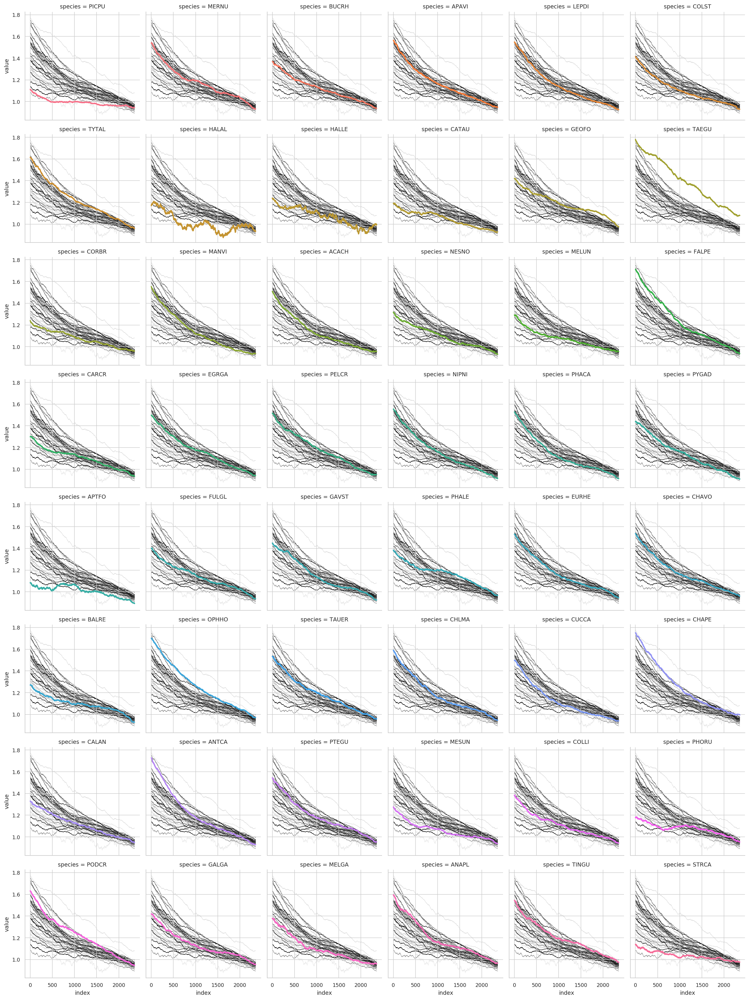

In [7]:
g = sns.FacetGrid(signatures,
                  col='species', hue='species',
                  col_wrap=6, sharey=True)
g.map(sns.lineplot, 'index', 'value', ci=None, linewidth=2)

for ax in g.axes.flat:
    sns.lineplot(x='index', y='value', hue='species', ci=None, 
                 palette='Greys', linewidth=0.5,
                 legend=False, zorder=0, data=signatures, ax=ax)

## Branch lenghts

In [ ]:
# branch_lengths = (pd.read_table('../plots/branchlengths.txt', names=['species', 'ancestor', 'branch_length'])
#                   .set_index('species')
#                  )                  
# branch_lengths.head()

UPGMA code:

In [ ]:
def find_lowest_cell(table):
    x = 1
    y = 0
    min_val = table[x][y]
    for i in range(len(table)):
        for j in range(len(table[i])):
            if table[i][j] < min_val:
                min_val = table[i][j]
                x = i
                y = j
    return [x, y]

def link(x, y, wx, wy):
    return (x * wx + y * wy) / (wx + wy)

def update_table(table, a, b, weight_a, weight_b):
    for i in range(0, b):
        table[b][i] = link(table[b][i], table[a][i], weight_b, weight_a)
    for j in range(b+1, a):
        table[j][b] = link(table[j][b], table[a][j], weight_b, weight_a)
    for i in range(a+1, len(table)):
        table[i][b] = link(table[i][b], table[i][a], weight_b, weight_a)
    for i in range(a+1, len(table)):
        del table[i][a]
    del table[a] 

def update_labels(labels, i, j, di, dj):
    labels[j] = "({}:{},{}:{})".format(labels[j], dj, labels[i], di)
    del labels[i]

def upgma(mat, names):

    table = mat[:]
    labels = names[:]
    node_heights = [0 for _ in labels]

    while len(labels) > 1:
        i, j = find_lowest_cell(table)
        
        dist = table[i][j]

        wi = max(1, labels[i].count(':'))
        wj = max(1, labels[j].count(':'))

        new_node_height = dist / 2
        di = new_node_height - node_heights[i]
        dj = new_node_height - node_heights[j]
        
        update_table(table, i, j, wi, wj)
        update_labels(labels, i, j, di, dj)
        node_heights[j] = new_node_height
        del node_heights[i]
        
    return labels[0] + ';'

Tree plotting code:

In [ ]:
def plot_tree(t, ax, leaf_colors=None, show_inner_nodes=False, fontsize=10, 
              text_offset=None, margins=(0.5, 1, 0.5, 1)): # top, right, bottom, left

    y_offset = len(t.get_leaves())
    for node in t.traverse("preorder"):
        node.x_offset = node.dist + sum(x.dist for x in node.get_ancestors())
        if node.is_leaf():
            y_offset -= 1
            node.y_offset = y_offset

    for node in t.traverse("postorder"):
        if not node.is_leaf():
            node.y_offset = sum(x.y_offset for x in node.children) / len(node.children)

    horizontal_lines = list()
    vertical_lines = list()
    node_coords = list()
    leaf_coords = list()
    max_x_offset = 0
    for node in t.traverse("postorder"):
        max_x_offset = max(max_x_offset, node.x_offset)
        node_coords.append((node.x_offset, node.y_offset))
        if node.is_leaf():
            leaf_coords.append([node.name, node.x_offset, node.y_offset])
        if not node.is_root():
            y = node.y_offset
            horizontal_lines.append(([node.up.x_offset, node.x_offset], [y, y]))
        if not node.is_leaf():
            c = sorted(node.children, key=lambda x: x.y_offset)
            bottom, top = c[0], c[-1]
            x = node.x_offset
            vertical_lines.append(([x, x],[bottom.y_offset, top.y_offset]))

    
    # shift the tree to put leaves at zero
    for i in range(len(horizontal_lines)):
        horizontal_lines[i][0][0] -= max_x_offset
        horizontal_lines[i][0][1] -= max_x_offset
    for i in range(len(vertical_lines)):
        vertical_lines[i][0][0] -= max_x_offset
        vertical_lines[i][0][1] -= max_x_offset
    for i in range(len(leaf_coords)):
        leaf_coords[i][1] -= max_x_offset
            
    # draw the tree:
    for x in horizontal_lines:
        ax.plot(*x, c='black', linewidth=0.8)
    for x in vertical_lines:
        ax.plot(*x, c='black', linewidth=0.8)

#     for tup in node_coords:
#         ax.plot(*tup, c='black', marker="o")

    if text_offset is None:
        text_offset = max_x_offset / 20
        
    for name, x, y in leaf_coords:
        ax.text(x+text_offset, y, name, fontsize=fontsize,
                verticalalignment='center', horizontalalignment='left')
        if leaf_colors is None:
            color = 'black'
        else:
            color = leaf_colors[name]
        ax.plot(x, y, c=color, marker="o", ms=3)


#     ax.set_xlim(-margins[3], max_x_offset + margins[1])
    ax.set_xlim(-margins[3]-max_x_offset, margins[1])
    ax.set_ylim(-margins[2], len(leaf_coords)-1+margins[0])


    #ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

    ax.spines['top'].set_visible(False) 
    ax.spines['left'].set_visible(False) 
    ax.spines['right'].set_visible(False)
    
    ax.xaxis.set_major_locator(plt.MaxNLocator(4))
    
    return leaf_coords


def make_comb_tree(t):
    for node in t.traverse():
        if not node.is_leaf():
            node.children = sorted(node.children, key=lambda c: len(c.get_leaves()), reverse=False)
    

Read in tree make ultrametric version:

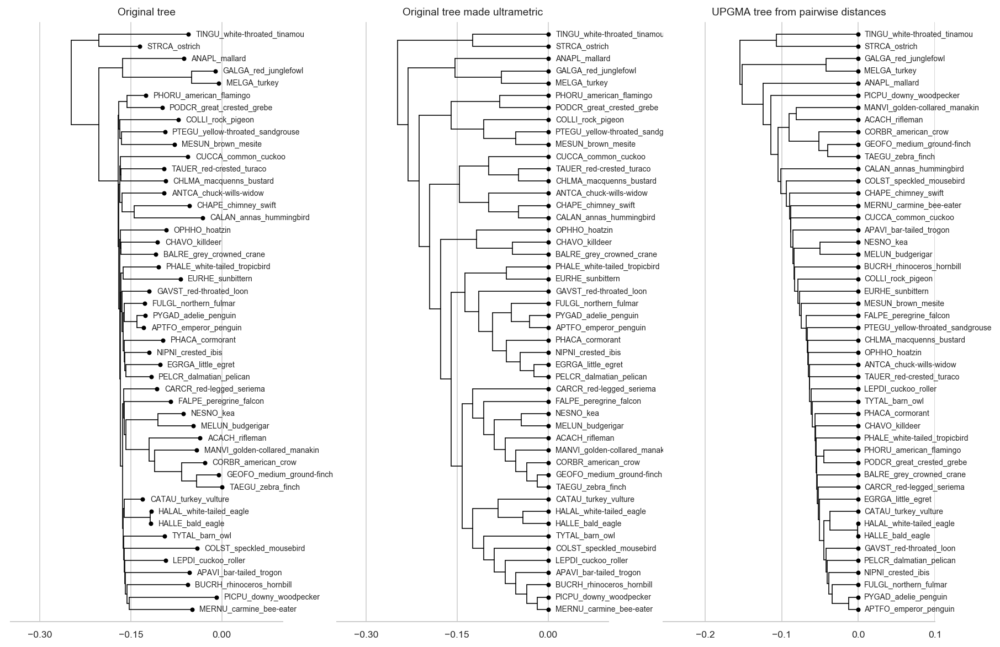

In [9]:
with open('../plots/tree_ancestors_species2014_english.txt') as f:
    s = f.read().strip()
tree = ete3.Tree(s, format=1)

name_list = tree.get_leaf_names()

lowtri = list()
for i in range(len(name_list)):
    lowtri.append([])
    for j in range(i):
        lowtri[i].append((tree&name_list[i]).get_distance(name_list[j]))
        
upgma_tree = ete3.Tree(upgma(lowtri, name_list), format=1)

ultrametric_tree = tree.copy()
ultrametric_tree.convert_to_ultrametric()

make_comb_tree(tree)
make_comb_tree(ultrametric_tree)
make_comb_tree(upgma_tree)
#tree.convert_to_ultrametric()
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 10))
leaf_info = plot_tree(tree, ax1, margins=(1, 0.1, 1, 0.1), fontsize=7)
ax1.set_title('Original tree')
leaf_info = plot_tree(ultrametric_tree, ax2, margins=(1, 0.1, 1, 0.1), fontsize=7)
ax2.set_title('Original tree made ultrametric')
leaf_info = plot_tree(upgma_tree, ax3, margins=(1, 0.1, 1, 0.1), fontsize=7)
ax3.set_title('UPGMA tree from pairwise distances') ;

Get external branch lengths:

In [10]:
records = list()
for node in tree.traverse():
    if node.is_leaf():
        records.append((node.name.split('_')[0], node.up.name, node.get_distance(node.up)))
orig_branch_lengths = pd.DataFrame.from_records(records, columns=['species', 'ancestor', 'branch_length'])

records = list()
for node in ultrametric_tree.traverse():
    if node.is_leaf():
        records.append((node.name.split('_')[0], node.get_distance(node.up)))
ultrametric_branch_lengths = pd.DataFrame.from_records(records, columns=['species', 'ultra_branch_length'])

branch_lengths = (orig_branch_lengths
 .merge(ultrametric_branch_lengths, on='species')
)
branch_lengths.head()

,species,ancestor,branch_length,ultra_branch_length
0,TINGU,Anc02,0.147138,0.124090
1,STRCA,Anc02,0.066905,0.124090
2,ANAPL,Anc04,0.100287,0.153635
3,GALGA,Anc07,0.039056,0.076818
4,MELGA,Anc07,0.044937,0.076818


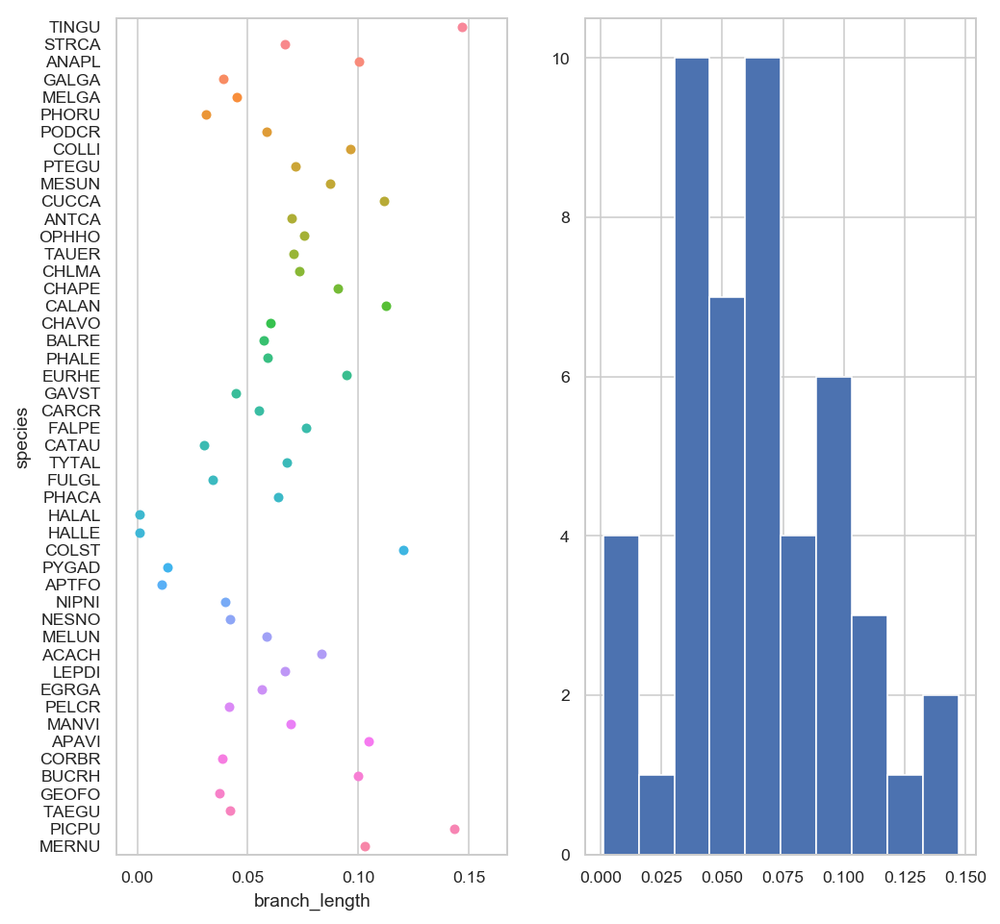

In [11]:
plot_df = branch_lengths.reset_index()#.loc[lambda df: ~df.species.str.startswith('Anc')]

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8,8))
ax = sns.stripplot(y="species", x="branch_length", 
                   data=plot_df,
                   jitter=0, ax=ax1)
ax = ax2.hist(plot_df.branch_length)

## Substutition rates

In [12]:
all_data = pd.read_table('../plots/table.ZF.bpen5.shared_hotspots.heat5.ancestor.1000.100kb.txt', sep=' ')
#all_data = pd.read_table('../plots/table.ZF.bpen5.shared_hotspots.heat5.ancestor.1000.txt', sep=' ')
all_data.head()

,species,feature,composition,value,kb
0,ACACH,ZF.bpen5.shared_hotspots.heat5,abs_cov,0.800991,-100
1,ACACH,ZF.bpen5.shared_hotspots.heat5,abs_cov,0.798069,-99
2,ACACH,ZF.bpen5.shared_hotspots.heat5,abs_cov,0.798595,-98
3,ACACH,ZF.bpen5.shared_hotspots.heat5,abs_cov,0.803331,-97
4,ACACH,ZF.bpen5.shared_hotspots.heat5,abs_cov,0.796852,-96




Compile a data frame with just the rate information:

In [13]:
2.3e-9 * 60e6


0.13799999999999998

In [14]:
patterns = ['rA2C', 'rT2G',
            'rA2G', 'rT2C',
            'rA2T', 'rT2A', 
            'rC2A', 'rG2T',
            'rC2G', 'rG2C', 
            'rC2T', 'rG2A']
subst_data = (all_data
              .loc[~all_data.species.str.startswith('Anc')]
              .loc[all_data.composition.isin(patterns), ['species', 'composition', 'value', 'kb']]
              .rename(index=str, columns={"composition": "pattern"})
              .merge(branch_lengths, on='species', how='left')
              .assign(subst = lambda df: [x in ['rA2G', 'rG2A', 'rT2C', 'rC2T'] and 'transition' or 'transversion' for x in df.pattern])
             )

# normalize with branch length (nr subst):
subst_data['rate'] = subst_data.value / subst_data.branch_length
# # normalize with expected nr subst in 60 mill years:
# subst_data['rate'] = subst_data.value / 2.3e-9 * 60e6

# To get something like a per million year mutation rate:
subst_data['rate'] *= 2.3e-9 * 1e6 

# Direct estimate of the rate of germline mutation in a bird, Smeds et al 2016




subst_data['pattern'] = pd.Categorical(subst_data.pattern.values, categories=patterns, ordered=True)

subst_data.head()

,species,pattern,value,kb,ancestor,branch_length,ultra_branch_length,subst,rate
0,ACACH,rA2C,0.014475,-100,Anc36,0.083568,0.070909,transversion,0.000398
1,ACACH,rA2C,0.014200,-99,Anc36,0.083568,0.070909,transversion,0.000391
2,ACACH,rA2C,0.014563,-98,Anc36,0.083568,0.070909,transversion,0.000401
3,ACACH,rA2C,0.014485,-97,Anc36,0.083568,0.070909,transversion,0.000399
4,ACACH,rA2C,0.014356,-96,Anc36,0.083568,0.070909,transversion,0.000395


Plot all species for each rate:

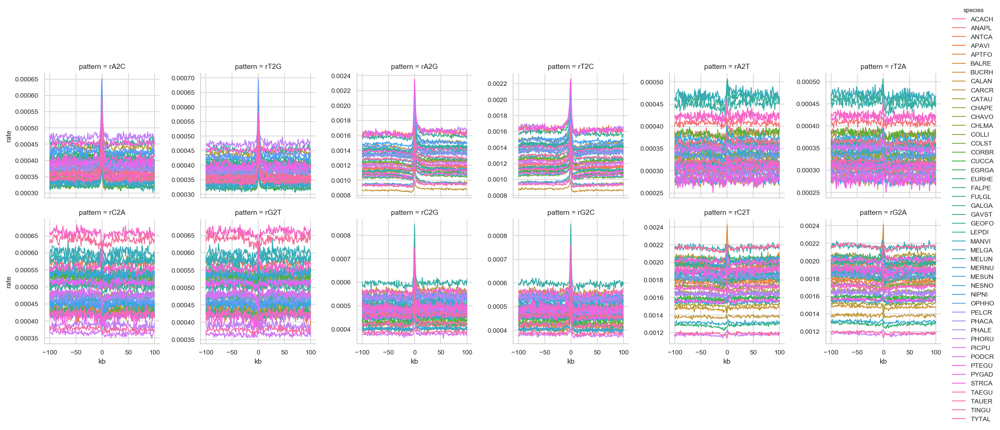

In [15]:
g = sns.FacetGrid(subst_data.loc[~subst_data.species.isin(['HALAL', 'HALLE'])],
                  col='pattern', hue='species',
                  col_wrap=6, sharey=False)
g.map(sns.lineplot, 'kb', 'rate').add_legend() ;

Plot all rates for each species:

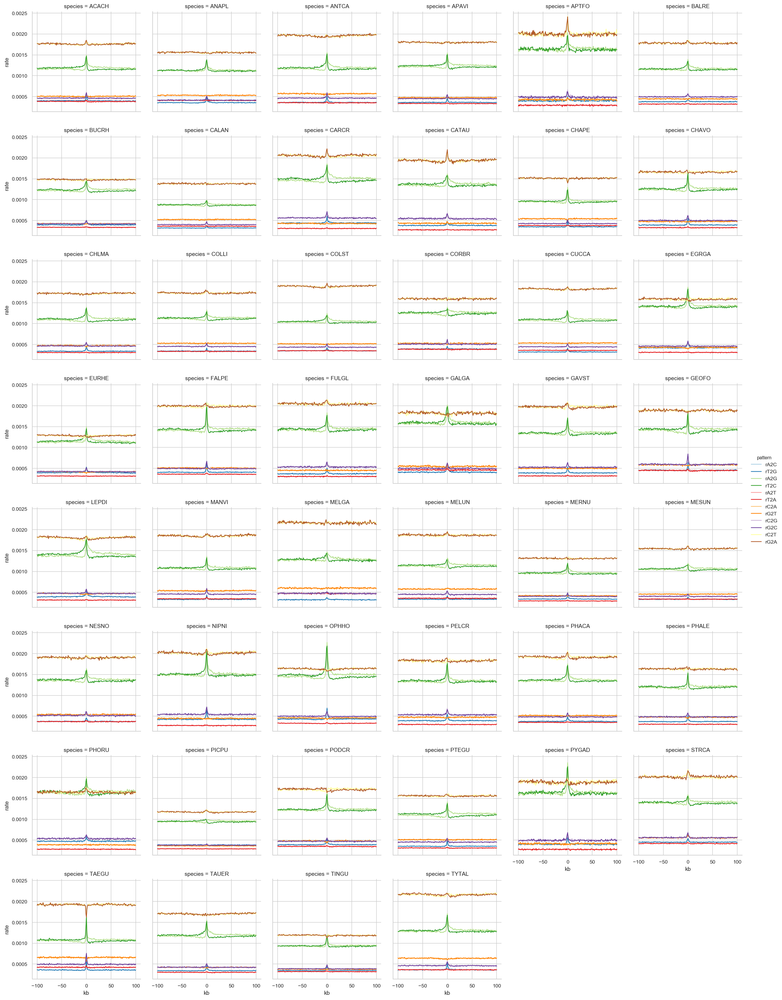

In [16]:
with sns.color_palette("Paired"):
    g = sns.FacetGrid(subst_data.loc[~subst_data.species.isin(['HALAL', 'HALLE'])],
                      col='species', hue='pattern',
                      col_wrap=6, sharey=True)#, ylim=(0,1.2))
    g.map(sns.lineplot, 'kb', 'rate').add_legend()

Plot all transversion rates for each species:

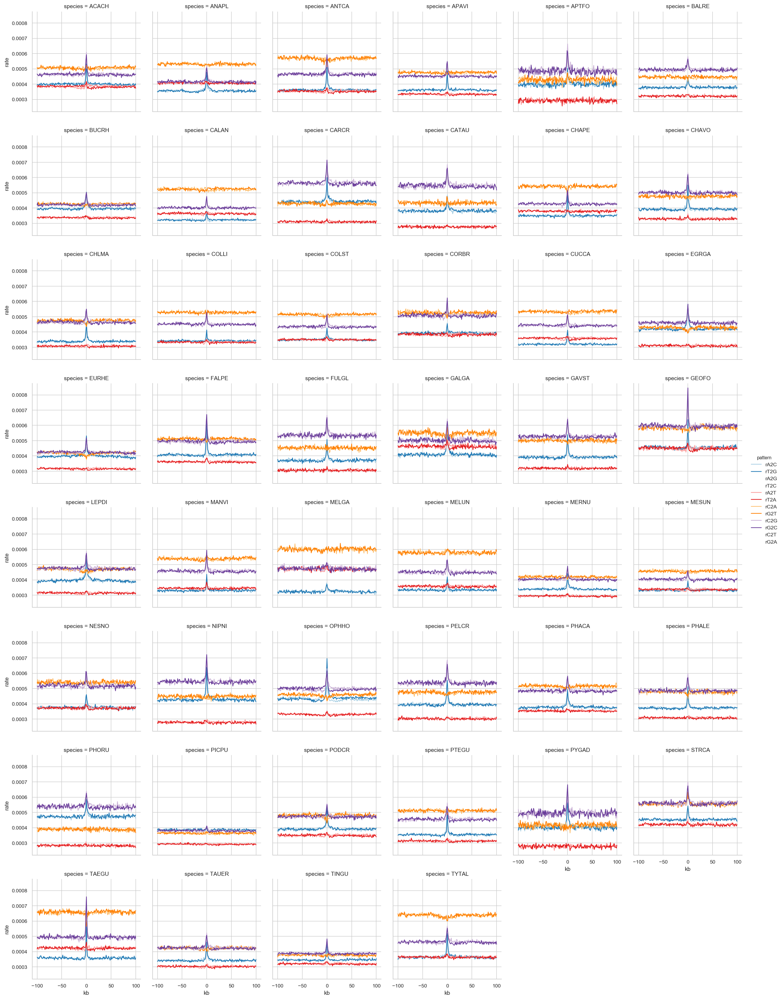

In [17]:
with sns.color_palette("Paired"):
    g = sns.FacetGrid(subst_data.loc[(subst_data.subst == 'transversion') \
                                     & (~subst_data.species.isin(['HALAL', 'HALLE']))],
                      col='species', hue='pattern',
                      col_wrap=6, sharey=True)#, ylim=(0.1, 0.3))
    g.map(sns.lineplot, 'kb', 'rate').add_legend()

Plot all transition rates for each species:

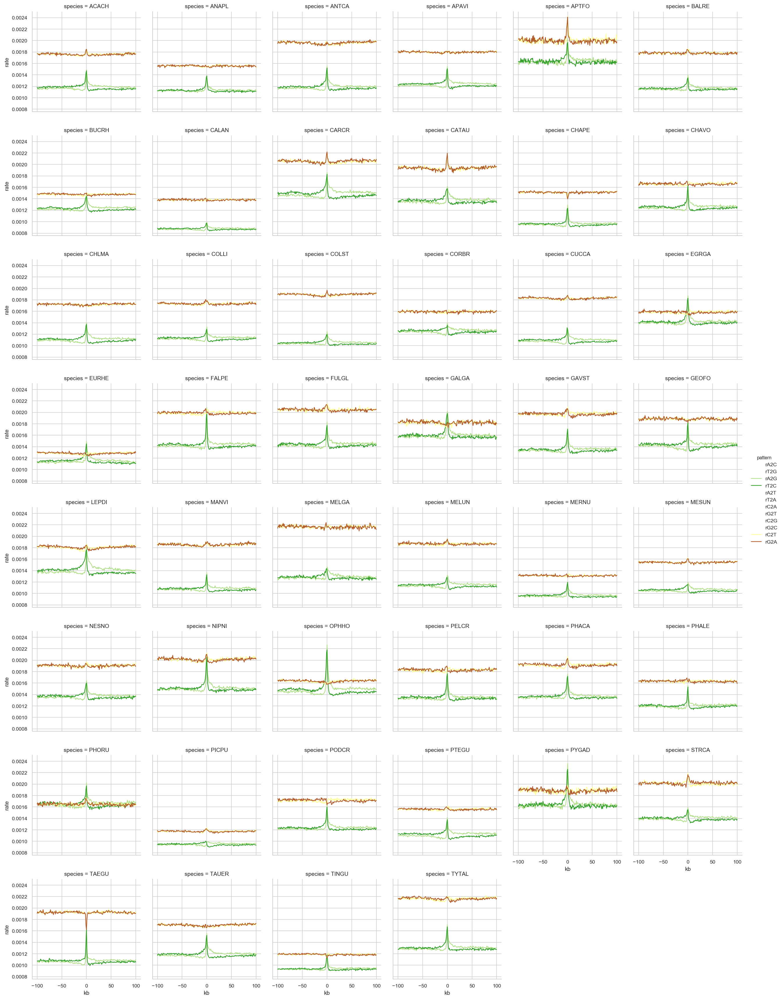

In [18]:
with sns.color_palette("Paired"):
    g = sns.FacetGrid(subst_data.loc[(subst_data.subst == 'transition') \
                                      & (~subst_data.species.isin(['HALAL', 'HALLE']))],
                      col='species', hue='pattern',
                      col_wrap=6, sharey=True)#, ylim=(0.4, 1))
    g.map(sns.lineplot, 'kb', 'rate').add_legend()

## Substutition rates folded across hotspot center

In [19]:
paired_patterns = [('rT2G', 'rA2C'),
                   ('rA2G', 'rT2C'),
                   ('rA2T', 'rT2A'), 
                   ('rG2T', 'rC2A'),
                   ('rC2G', 'rG2C'), 
                   ('rC2T', 'rG2A')]
swapped = [(b, a) for a, b in paired_patterns]

d = dict(paired_patterns + swapped)

subst_data['fold_kb'] = subst_data.kb.abs()
subst_data['fold_pattern'] = subst_data.pattern
subst_data.loc[subst_data.kb < 0, 'fold_pattern'] = [d[x] for x in subst_data.loc[subst_data.kb < 0, 'fold_pattern']]
subst_data.head()

,species,pattern,value,kb,ancestor,branch_length,ultra_branch_length,subst,rate,fold_kb,fold_pattern
0,ACACH,rA2C,0.014475,-100,Anc36,0.083568,0.070909,transversion,0.000398,100,rT2G
1,ACACH,rA2C,0.014200,-99,Anc36,0.083568,0.070909,transversion,0.000391,99,rT2G
2,ACACH,rA2C,0.014563,-98,Anc36,0.083568,0.070909,transversion,0.000401,98,rT2G
3,ACACH,rA2C,0.014485,-97,Anc36,0.083568,0.070909,transversion,0.000399,97,rT2G
4,ACACH,rA2C,0.014356,-96,Anc36,0.083568,0.070909,transversion,0.000395,96,rT2G


In [20]:
plot_df = subst_data.groupby(['species', 'fold_kb', 'subst', 'fold_pattern']).mean().reset_index()

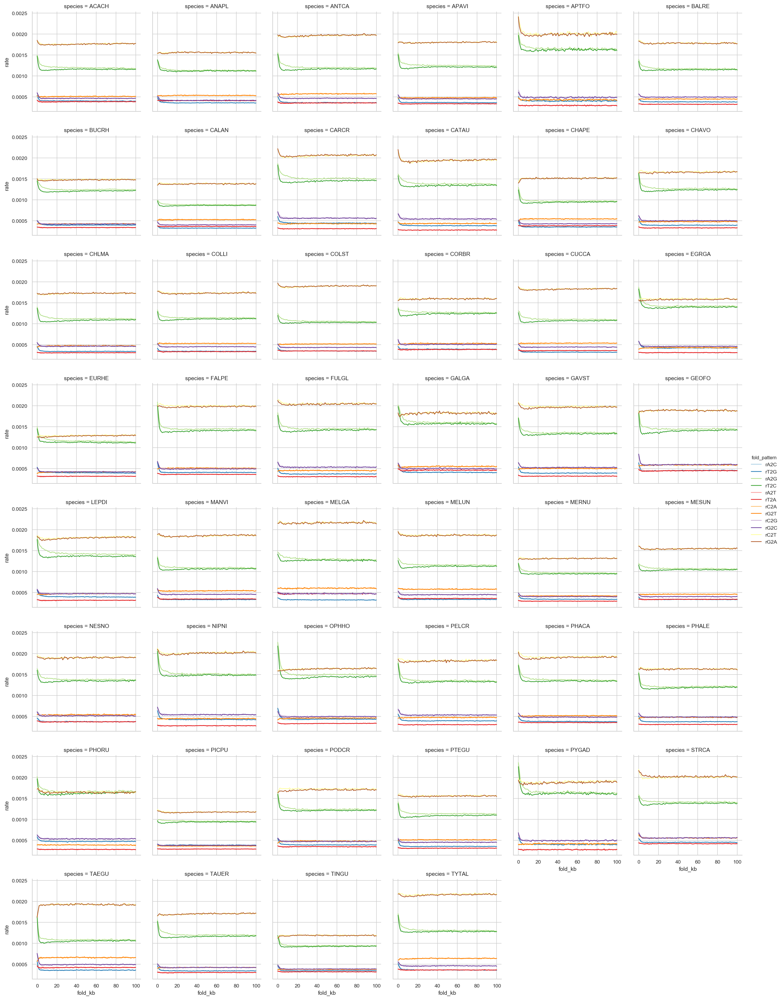

In [21]:
with sns.color_palette("Paired"):
    g = sns.FacetGrid(plot_df.loc[~plot_df.species.isin(['HALAL', 'HALLE'])],
                      col='species', hue='fold_pattern',
                      col_wrap=6, sharey=True)#, ylim=(0,1.2))
    g.map(sns.lineplot, 'fold_kb', 'rate').add_legend()
#     for ax in g.axes.flat:
#         ax.set_ylim(top=1)
    #sns.lineplot(x='kb', y='rate', hue='pattern', style='species', data=subst_data)

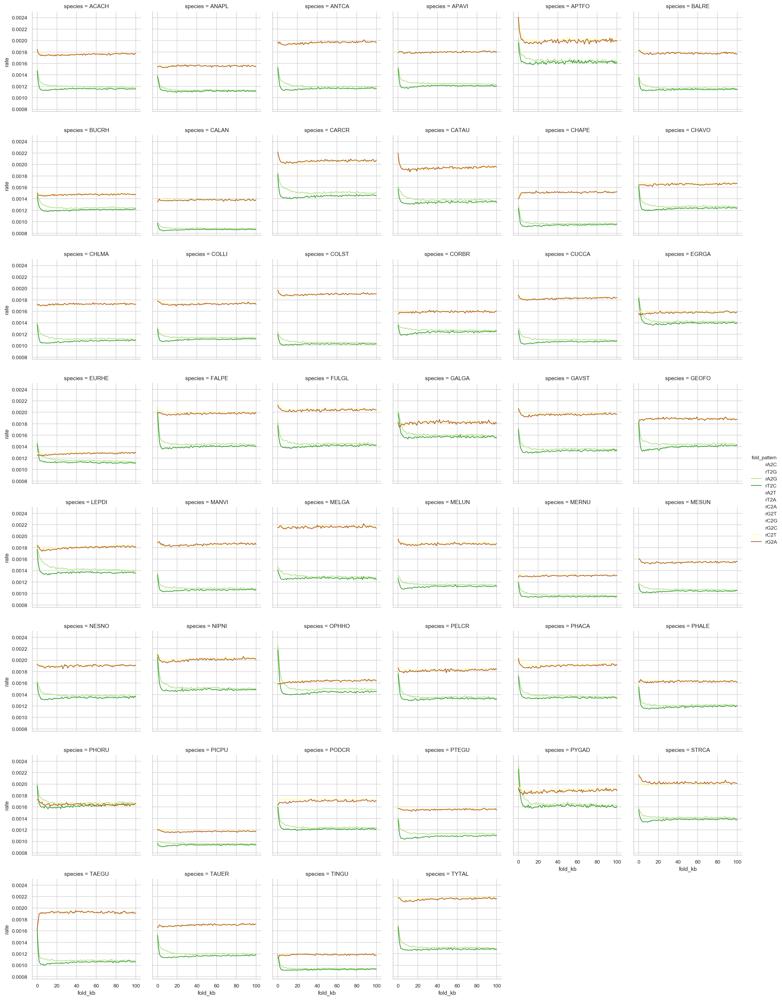

In [22]:
with sns.color_palette("Paired"):
    g = sns.FacetGrid(plot_df.loc[(plot_df.subst == 'transition') \
                                  & (~plot_df.species.isin(['HALAL', 'HALLE']))],
                      col='species', hue='fold_pattern',
                      col_wrap=6, sharey=True)#, ylim=(0.1, 0.3))
    g.map(sns.lineplot, 'fold_kb', 'rate').add_legend()

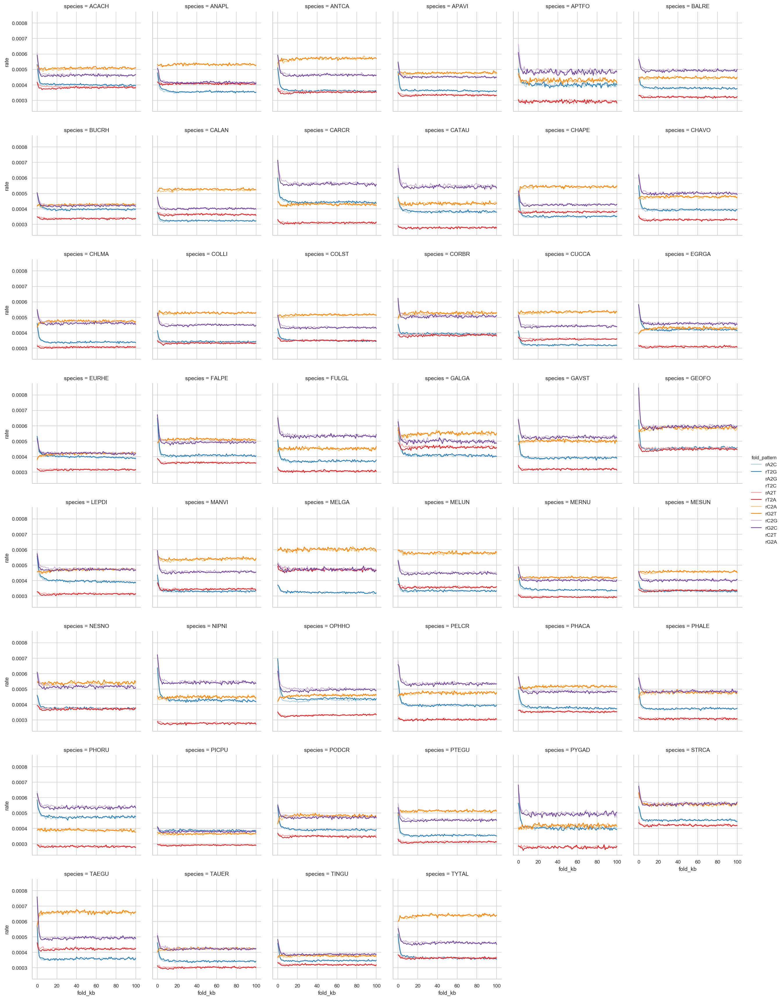

In [23]:
with sns.color_palette("Paired"):
    g = sns.FacetGrid(plot_df.loc[(plot_df.subst == 'transversion') \
                                  & (~plot_df.species.isin(['HALAL', 'HALLE']))],
                      col='species', hue='fold_pattern',
                      col_wrap=6, sharey=True, 
#                       ylim=(0.4, 1)
                     )
    g.map(sns.lineplot, 'fold_kb', 'rate').add_legend()

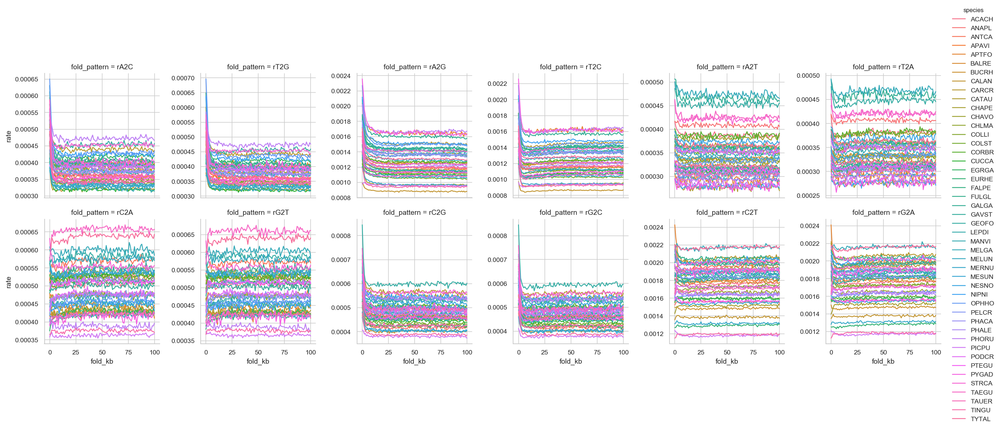

In [24]:
g = sns.FacetGrid(plot_df.loc[~plot_df.species.isin(['HALAL', 'HALLE'])],
                  col='fold_pattern', hue='species',
                  col_wrap=6, sharey=False)
g.map(sns.lineplot, 'fold_kb', 'rate').add_legend() ;

## Pure rotational symetry bias in substitution rates

For now just the rA2G and rT2C rates divided by their sum.

In [25]:
rate_table = pd.pivot_table(subst_data, index=['species', 'kb'], columns='pattern', values='rate')
rate_table.columns = rate_table.columns.astype('str')
for a, b in paired_patterns:
    rate_table[f'{a}-{b}'] = rate_table[a] - rate_table[b]
# rate_table.head()

In [26]:
plot_df = rate_table[['rA2G', 'rT2C']].assign(rA2G_norm=lambda df: df.rA2G/(df.rA2G + df.rT2C),
                                              rT2C_norm=lambda df: df.rT2C/(df.rA2G + df.rT2C))
plot_df = plot_df[['rA2G_norm', 'rT2C_norm']].reset_index().melt(id_vars=['species', 'kb'])
plot_df.head(1)

,species,kb,pattern,value
0,ACACH,-100,rA2G_norm,0.49383


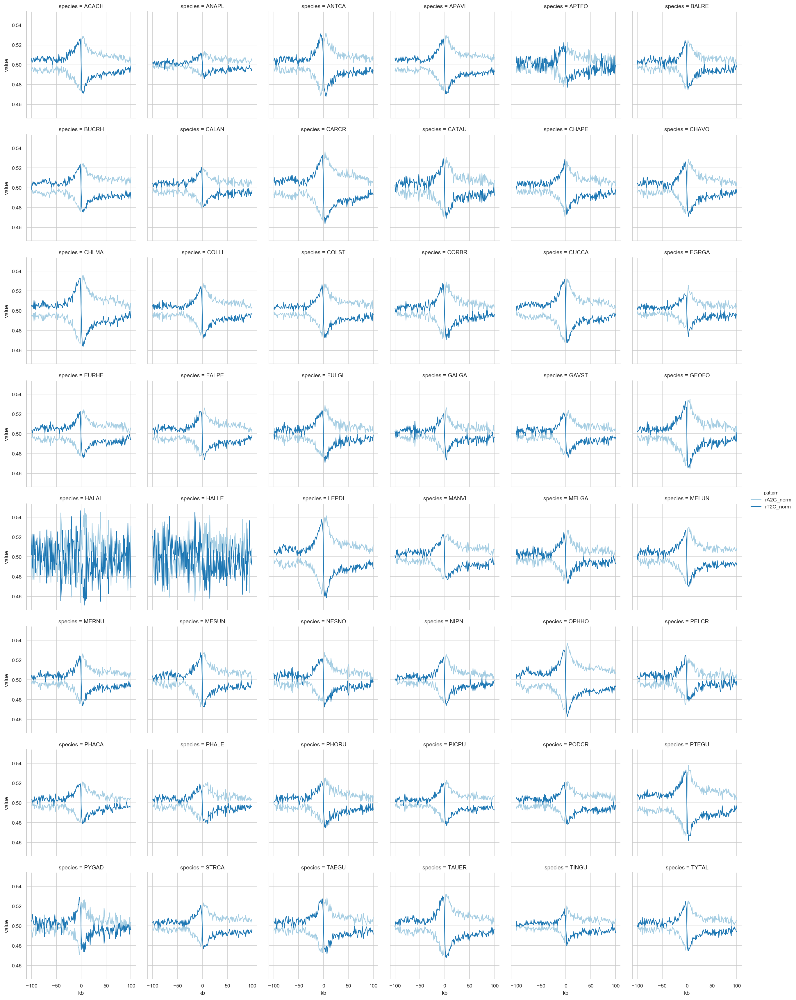

In [27]:
with sns.color_palette("Paired"):
    g = sns.FacetGrid(plot_df,
                      col='species', hue='pattern',
                      col_wrap=6, sharey=True)
    g = g.map(sns.lineplot, 'kb', 'value').add_legend()

## Compute are under bias curves

In [28]:
def get_abs_area(df):
    return np.trapz((df.value-0.5).abs(), x=df.kb)
integrated_bias = plot_df.groupby(['species', 'pattern']).apply(get_abs_area).to_frame('total_bias').reset_index()
# integrated_bias.head()

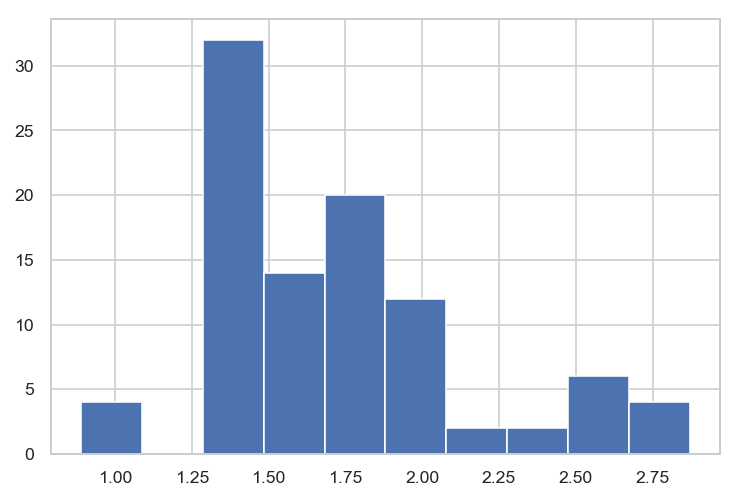

In [29]:
plt.hist(integrated_bias.total_bias) ;

## Rates folded to augmnet power to seee rotational bias

In [30]:
plot_df = (rate_table[['rT2G-rA2C', 'rA2G-rT2C', 'rA2T-rT2A',
                       'rG2T-rC2A', 'rC2G-rG2C', 'rC2T-rG2A']]
           .reset_index()
           .melt(id_vars=['species', 'kb'], value_name='rate')
          )
#plot_df.head()

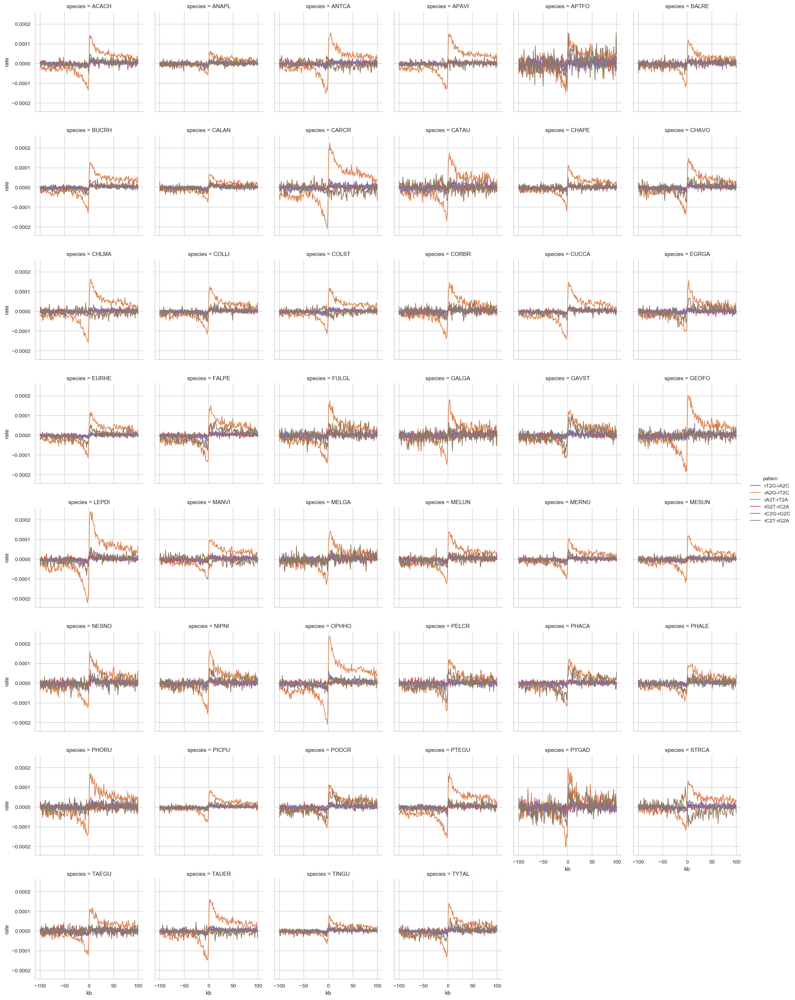

In [31]:
g = sns.FacetGrid(plot_df.loc[~plot_df.species.isin(['HALAL', 'HALLE'])],
                  col='species', hue='pattern',
                  col_wrap=6, sharey=True)
g = g.map(sns.lineplot, 'kb', 'rate').add_legend()

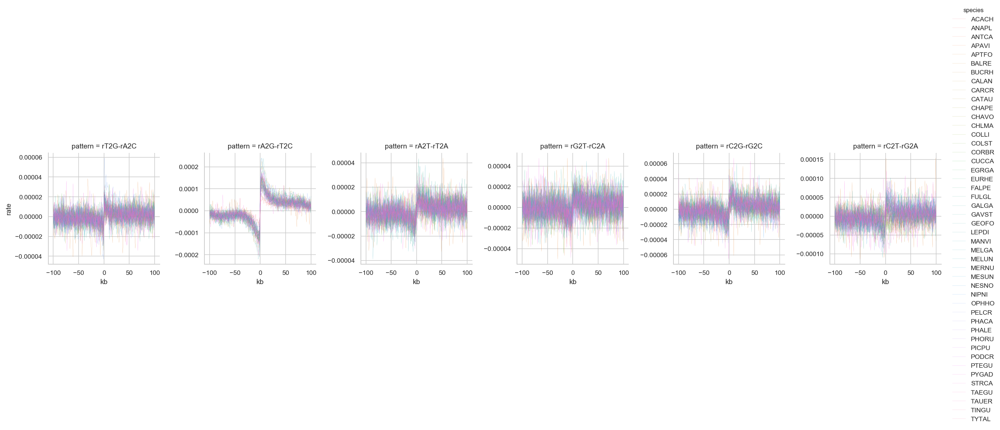

In [32]:
g = sns.FacetGrid(plot_df.loc[~plot_df.species.isin(['HALAL', 'HALLE'])],
                  col='pattern', hue='species',
                  col_wrap=6, sharey=False)
g = g.map(sns.lineplot, 'kb', 'rate', linewidth=0.1).add_legend()

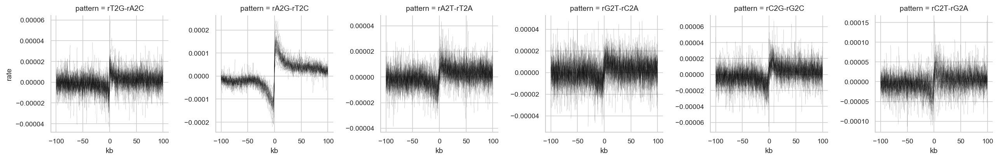

In [33]:
g = sns.FacetGrid(plot_df.loc[~plot_df.species.isin(['HALAL', 'HALLE'])],
                  col='pattern', hue='species',
                  col_wrap=6, sharey=False)
g = g.map(sns.lineplot, 'kb', 'rate', linewidth=0.05, color='black')

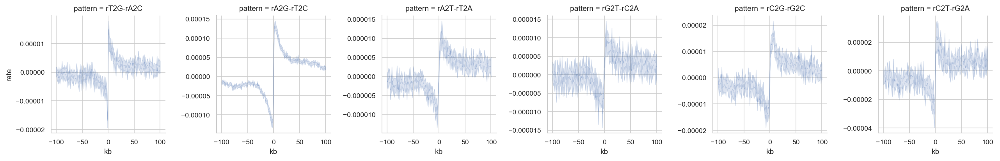

In [34]:
g = sns.FacetGrid(plot_df.loc[~plot_df.species.isin(['HALAL', 'HALLE'])],
                  col='pattern',
                  col_wrap=6, sharey=False)
g = g.map(sns.lineplot, 'kb', 'rate', linewidth=0.1)

## Base composition around hotspots

In [35]:
bases = ['nA', 'nC', 'nG', 'nT', 'nGC', 'nAT']
          
totals = (all_data
          .loc[all_data.composition == 'nACGT', ['species', 'value', 'kb']]
          .rename(index=str, columns={'value': 'total'})
         )
totals.head()          

,species,total,kb
1407,ACACH,800.711033,-100
1408,ACACH,797.789142,-99
1409,ACACH,798.314886,-98
1410,ACACH,803.050088,-97
1411,ACACH,796.573380,-96


In [36]:
comp_data = (all_data
              .loc[~all_data.species.str.startswith('Anc')]
              .loc[all_data.composition.isin(bases), ['species', 'composition', 'value', 'kb']]
              .rename(index=str, columns={"composition": "base", 'value': 'nrbases'})
              .merge(totals, on=['species', 'kb'], how='left')
              .assign(proportion=lambda df: df.nrbases / df.total)
             )

comp_data['base'] = pd.Categorical(comp_data.base.values, categories=bases, ordered=True)
comp_data.head()

,species,base,nrbases,kb,total,proportion
0,ACACH,nA,242.783888,-100,800.711033,0.303210
1,ACACH,nA,242.976532,-99,797.789142,0.304562
2,ACACH,nA,242.767075,-98,798.314886,0.304099
3,ACACH,nA,244.473905,-97,803.050088,0.304432
4,ACACH,nA,242.114536,-96,796.573380,0.303945


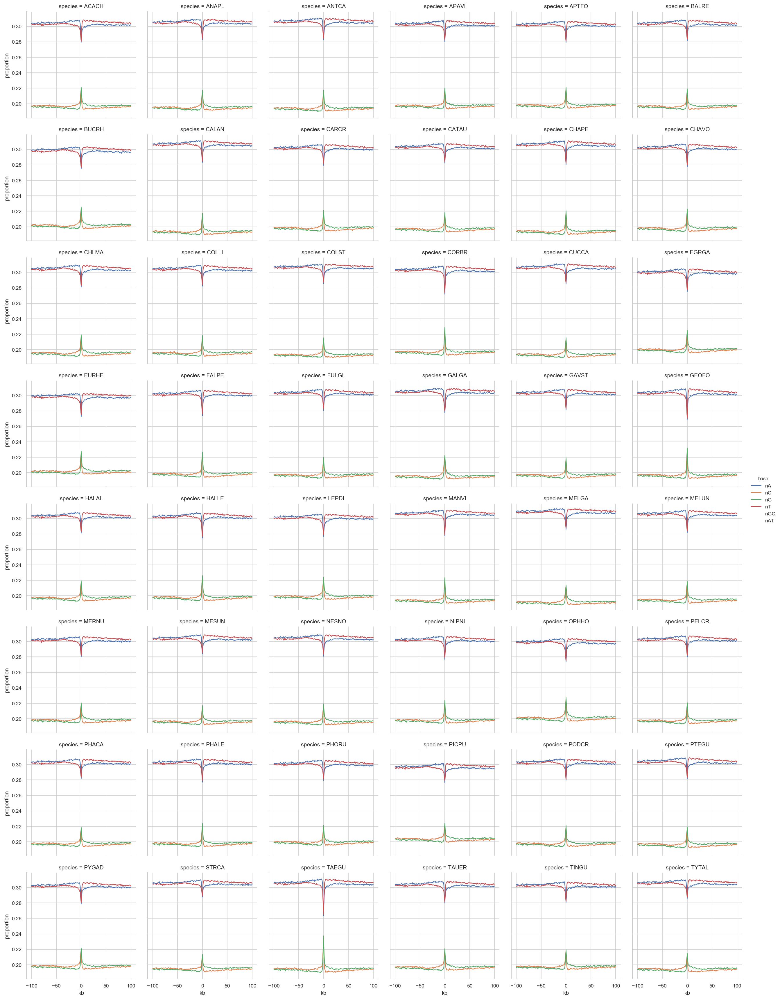

In [37]:
g = sns.FacetGrid(comp_data.loc[comp_data.base.isin(['nA', 'nT', 'nG', 'nC'])],
                  col='species', hue='base',
                  col_wrap=6, sharey=True)
g = g.map(sns.lineplot, 'kb', 'proportion').add_legend()

## Pure rotational symmetry

In [38]:
df = pd.pivot_table(comp_data, index=['species', 'kb'], columns=['base'], values='proportion')
df.columns = df.columns.astype('str')
df = df.reset_index()
df['nC_norm'] = df.nC / df.nGC
df['nG_norm'] = df.nG / df.nGC
df['nA_norm'] = df.nA / df.nAT
df['nT_norm'] = df.nT / df.nAT

In [39]:
plot_df = df.melt(id_vars=['species', 'kb'], value_vars=['nC_norm', 'nG_norm', 'nA_norm', 'nT_norm'])

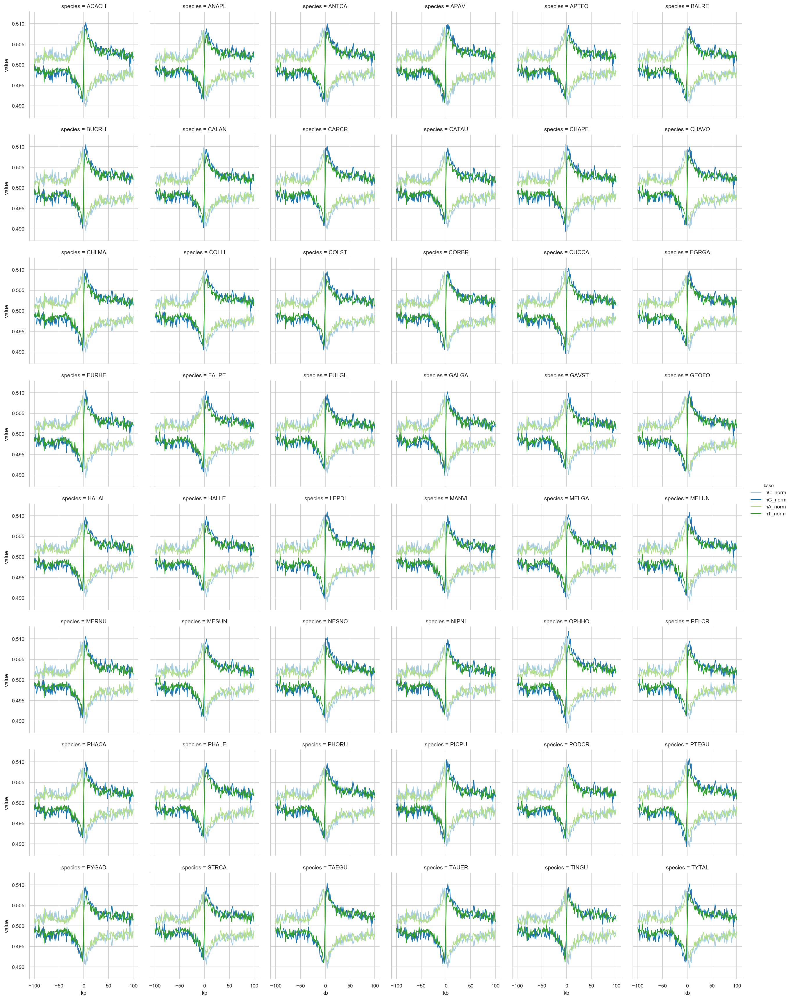

In [40]:
with sns.color_palette("Paired"):
    g = sns.FacetGrid(plot_df,
                      col='species', hue='base',
                      col_wrap=6, sharey=True)
    g = g.map(sns.lineplot, 'kb', 'value').add_legend()

- What does the W>S and S>W rates look like when we subtract?
- Is the W>S trend independent of the rotational bias (RB) trend? 
- Can they be separated? 
- Is the long range rotational bias trend independent of the W>S peak? 
- How far away from the hotspot do we need to go before the W>S gBGC is gone and only RB is left? 
- Can we date hotspots from RB alone? How many rates contribute to RB? 
- Can we exponentiate a matrix of reversed (transposed) rates and see how far back we need to go before the RB is gone? 

- Do we need to take recurrent mutation into account? Like a PAM matrix? (Maybe compute the probability of recurrent substitutions from the proportion of substations along the sequence.)

- Make a composition array and a substitution matrix for each position and then project each array backwards in time step by step until RB is gone.

```
>>> m
array([[1, 2, 3],
       [1, 2, 3],
       [1, 2, 3]])
>>> a
array([1, 2, 3])
>>> np.matmul(a, m)
array([[ 6, 12, 18]])
>>>
```

Does loss of PRDM9 coincide with some major event like [origin of X chromosomes](https://www.readcube.com/library/ff394a98-20f7-4882-871c-840e9f73d65b:46a55e43-0753-43ec-9c28-152417e103b5) >110 Mill BP or evolution of flight 120-150 Mill BP?

- What is the role of Ne in gBGC in each species? Could it be the reason why it it week or strong in different spcecies? 
- Is TAEGU qualitatively different?
-  

- What is the compositional bias around hotspots? It seems it is very similar among species. 
- Can we see that it is in ancestors in cactus alignment?
- can we use that and the rate differences to state prdm9 loss as the time it takes to accumulate the observed current bias?


- Why are have GC not reached GC*
- Are compositional asymmetry building and at what rate?
- Can we date PDRM9 loss from asymmetry?
- I guess the finch is not phased, so part of the reason asymmetry tails of could be that the further we get away from the hotspot, the less likely it is that phase is preserved.


That some species have stronger peaks than TAEGU suggests that differences between species are not due to differences in how many hotspots they share (see where TAEGU lies in the distribution).

How big are the effects, and how far away fro the hotspot do they stretch?

Are bN constant across species? Galtier says it is. Here it seems not to be the case. The effect of local Ne on gBGC must be linear just like b. But what is Ne as a function of recombination rate? (I guess that is in Davids paper). Also the b may not be linear with recombination rate (Galtier paper).

- All 12 mutation rates
- Does gBGC generate the rotational symmetry or are hotspots determined by the rotational symmetry?
- If DBS is mutagenic (see papers) then we expect to see peaks in both W>S and S>W even when there are no crossoves/conversion from strand invasion.

In [41]:
#comp_data.loc[(comp_data.species == 'ACACH') & (comp_data.base == 'nA')].groupby('kb').proportion.mean()

rows = list()

for species in comp_data.species.unique():
    for position in list(range(10, 30)) + list(range(-10, -30, -1)):

        base_comp = (comp_data
         .loc[(comp_data.species == species) & comp_data.base.isin(['nA', 'nC', 'nG', 'nT'])]
         .groupby(['base', 'kb'])
         .proportion
         .mean()
         .unstack()
         .sort_index()
        )

        subst_rates = (subst_data
         .loc[subst_data.species == species]
         .groupby(['pattern', 'kb'])
         .rate
         .mean()
         .unstack()
        )

        s = subst_rates[position]
        m = np.array([[0,             s.loc['rA2C'], s.loc['rA2G'], s.loc['rA2T']],
                      [s.loc['rC2A'], 0,             s.loc['rC2G'], s.loc['rC2T']],
                      [s.loc['rG2A'], s.loc['rG2C'], 0,             s.loc['rG2T']],
                      [s.loc['rT2A'], s.loc['rT2C'], s.loc['rT2G'], 0           ]])

        # get "backwards" matrix
        m = m.T

        for i, row in enumerate(m):
            m[i][i] = 1 - row.sum()

        a = base_comp[position].values
        a /= a.sum()

        for i in range(500):
            if position > 0:
                GCdiff = (a[3]-a[0]) / (a[3]+a[0])
                TAdiff = (a[2]-a[1]) / (a[2]+a[1])
            else:
                GCdiff = (a[0]-a[3]) / (a[3]+a[0])
                TAdiff = (a[1]-a[2]) / (a[2]+a[1])            
            rows.append((species, position, i, *a, GCdiff, TAdiff))
#             if not i % 10:
#                 print(a, GCdiff, TAdiff, i)
            a = np.matmul(a, m)

df = pd.DataFrame.from_records(rows, columns=['species', 'position', 'myr', 'A', 'C', 'G', 'T', 'TvsA', 'GvsC'])

In [42]:
plot_df = df[['species', 'position', 'myr', 'TvsA', 'GvsC']].melt(id_vars=['species', 'position', 'myr'])
plot_df.head()

,species,position,myr,variable,value
0,ACACH,10,0,TvsA,0.012885
1,ACACH,10,1,TvsA,0.012788
2,ACACH,10,2,TvsA,0.012691
3,ACACH,10,3,TvsA,0.012594
4,ACACH,10,4,TvsA,0.012497


## Compute date of loss of PRDM9

In [43]:
df = (plot_df
      .loc[(plot_df.species == 'TAEGU') & (plot_df.variable == 'TvsA') & (plot_df.position == 10)]
      .sort_values(by='myr')
     )

y = df.myr
x = df.value
df.head()

,species,position,myr,variable,value
880000,TAEGU,10,0,TvsA,0.013123
880001,TAEGU,10,1,TvsA,0.013054
880002,TAEGU,10,2,TvsA,0.012986
880003,TAEGU,10,3,TvsA,0.012917
880004,TAEGU,10,4,TvsA,0.012848


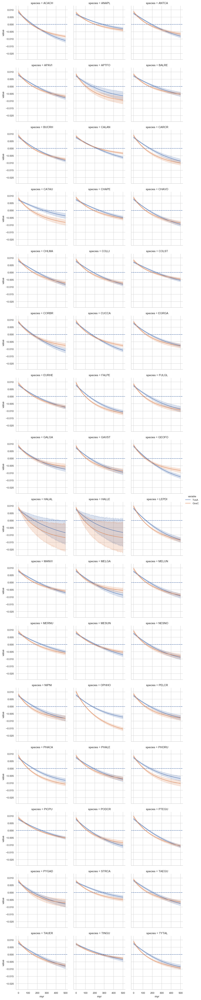

In [44]:
#with sns.color_palette("Paired"):
#with sns.axes_style('white'):
g = sns.FacetGrid(plot_df,
                  col='species', hue='variable',
                  col_wrap=3, sharey=True)
g = g.map(sns.lineplot, 'myr', 'value').add_legend()

for ax in g.axes.flat:
    ax.axhline(0, linestyle='dashed')

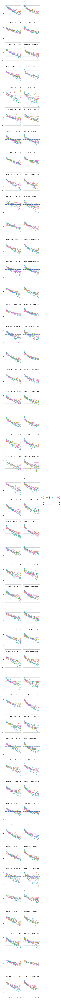

In [45]:
g = sns.FacetGrid(plot_df.loc[~plot_df.species.isin(['HALAL', 'HALLE'])],
                  row='species', col='variable', hue='position', sharey=True)
g = g.map(sns.lineplot, 'myr', 'value', ci=None, linewidth=0.5).add_legend(ncol=4)

for ax in g.axes.flat:
    ax.axhline(0, linestyle='dashed')

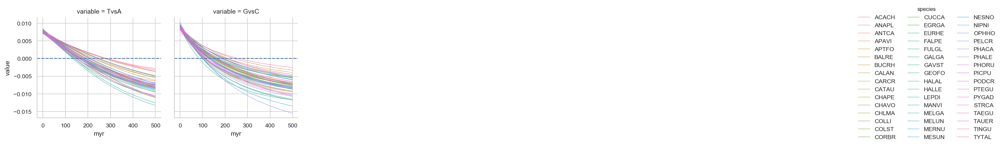

In [46]:
g = sns.FacetGrid(plot_df,
                  col='variable', hue='species',
                  col_wrap=6, sharey=True)
g = g.map(sns.lineplot, 'myr', 'value', linewidth=0.5, ci=None).add_legend(ncol=3)

for ax in g.axes.flat:
    ax.axhline(0, linestyle='dashed')

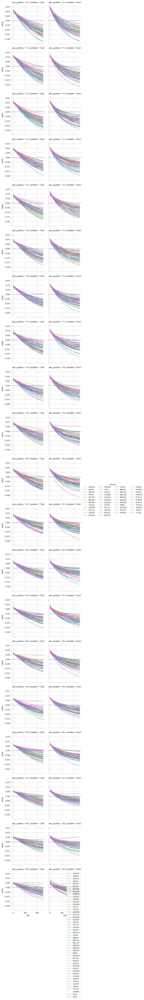

In [47]:
g = sns.FacetGrid(plot_df
                  .loc[~plot_df.species.isin(['HALAL', 'HALLE'])]
                  .assign(abs_position=lambda df: df.position.abs()),
                  row='abs_position', col='variable', hue='species', sharey=True)
g = g.map(sns.lineplot, 'myr', 'value', ci=None, linewidth=1).add_legend(ncol=4)

for ax in g.axes.flat:
    ax.axhline(0, linestyle='dashed')

sns.lineplot(x='myr', y='value', hue='variable', data=plot_df) ;

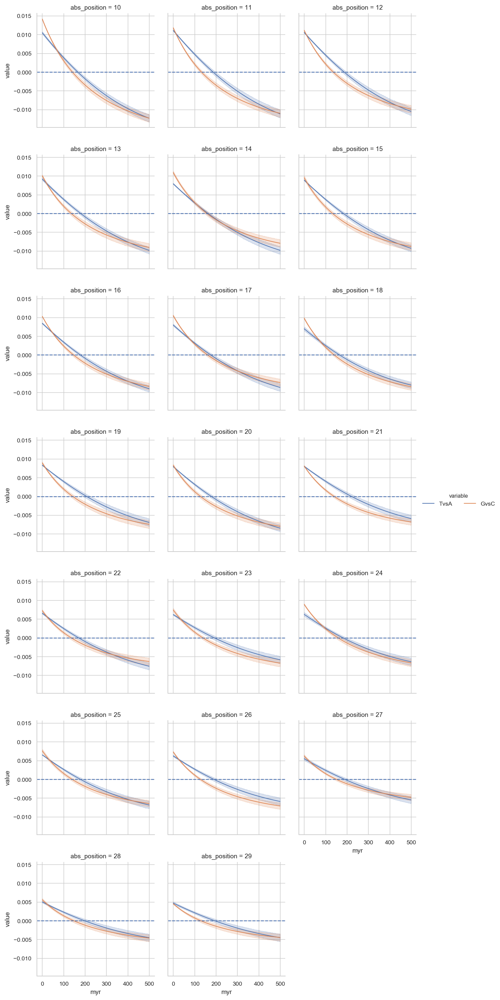

In [48]:
g = sns.FacetGrid(plot_df
                  .loc[~plot_df.species.isin(['HALAL', 'HALLE'])]
                  .assign(abs_position=lambda df: df.position.abs()),
                  col='abs_position', hue='variable', col_wrap=3, sharey=True)
g = g.map(sns.lineplot, 'myr', 'value', linewidth=1).add_legend(ncol=4)

for ax in g.axes.flat:
    ax.axhline(0, linestyle='dashed')
    

In one species, the lines should intersect at zero if the rates measured on the external branch are representative of the entire time back to immobilization of hotspots. Maybe use that to filter out species with strange mutation patterns.

It is a complication that the content bias may be smaller/larger than expected from the substitution bias on the external branch

We could check that by comparing to the ancestral sequence from cactus. 

In [49]:
from scipy.interpolate import interp1d

def get_date(df):
    try:
        return interp1d(df.value, df.myr)(0)
    except:
        return np.nan

loss_dates = plot_df.groupby(['species', 'position', 'variable']).apply(get_date).to_frame('date').reset_index()
loss_dates['date'] = loss_dates.date.astype('float')
loss_dates.head()

,species,position,variable,date
0,ACACH,-29,GvsC,99.115565
1,ACACH,-29,TvsA,138.642455
2,ACACH,-28,GvsC,136.564309
3,ACACH,-28,TvsA,311.078993
4,ACACH,-27,GvsC,107.370245


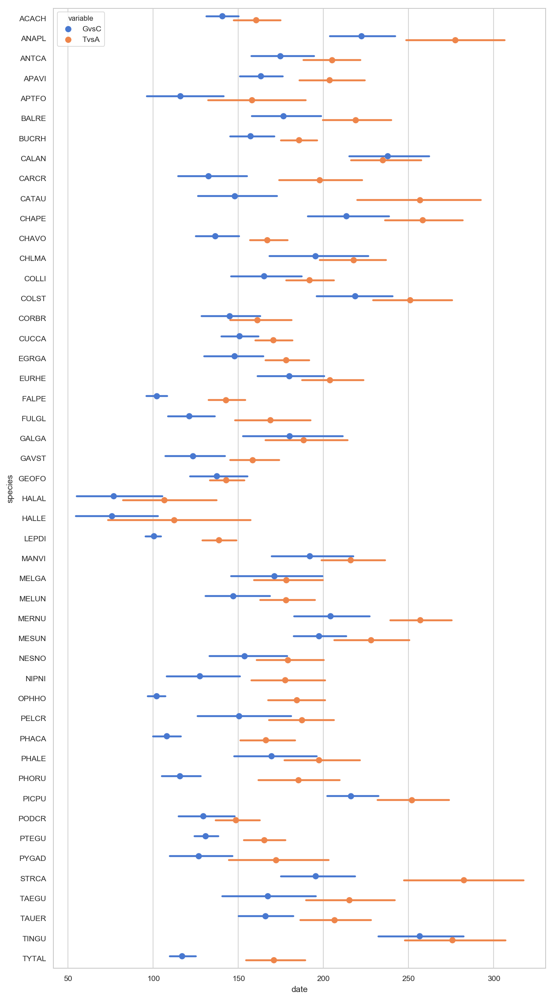

In [50]:
plt.figure(figsize=(10, 20))
#sns.catplot(x="sex", y="survived", hue="class", kind="point", data=titanic);

ax = sns.pointplot(y="species", x="date", hue="variable", dodge=0.2,
                    data=loss_dates, palette="muted", linestyles='none')

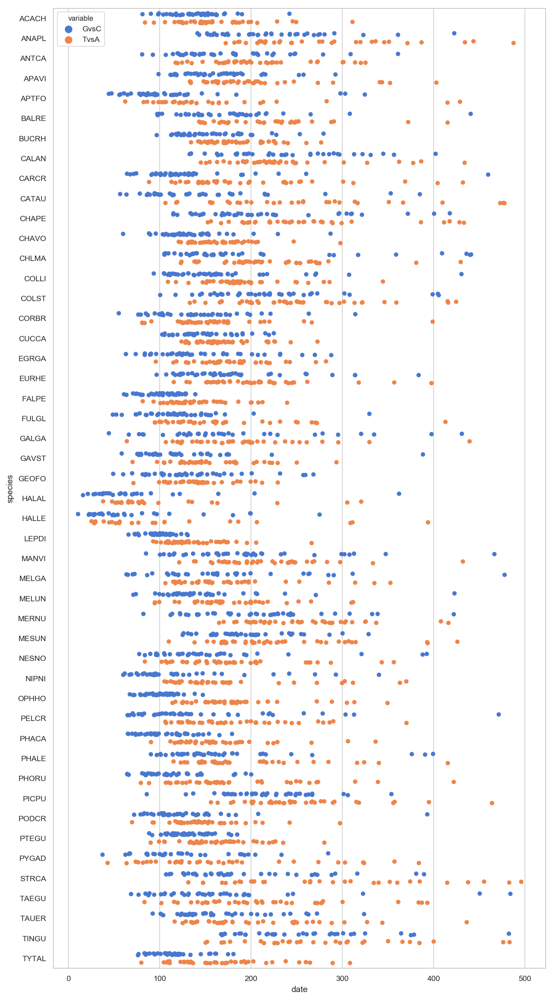

In [51]:
plt.figure(figsize=(10, 20))
ax = sns.stripplot(y="species", x="date", hue="variable", dodge=True, jitter=True,
                    data=loss_dates, palette="muted")

In [52]:
#loss_dates.groupby(['species', 'variable']).mean().reset_index()

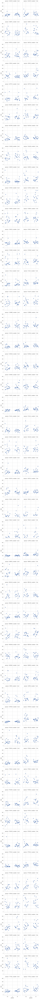

In [53]:
g = sns.FacetGrid(data=loss_dates, col='variable', row='species',
#                 ylim=(0, 50)
                 )
g.map(plt.scatter, 'position', 'date') ;

## How loss date relates to magnitude of bias, and branch length

In [54]:
comp_data.groupby('species').agg('mean').reset_index(), on=['species'])


SyntaxError: invalid syntax (<ipython-input-54-e893e80bfb00>, line 1)

In [ ]:
df = (loss_dates
      .groupby(['species', 'variable'])
      .apply(lambda df: df.date.mean())
      .to_frame('mean_date')
      .reset_index()
      .pivot(index='species', columns='variable', values='mean_date')
      .reset_index(level=['species'])
      .rename(columns={'GvsC': 'date_GvsC', 'TvsA': 'date_TvsA'})
      .merge(integrated_bias.groupby('species').agg('mean').reset_index(), on=['species'])

      .merge(comp_data.loc[comp_data.base == 'nGC'].groupby(['species']).proportion.mean().to_frame('GCproportion'), on=['species'])

      .merge(branch_lengths.reset_index().loc[lambda df: ~df.species.str.startswith('Anc')][['species', 'branch_length']], on=['species'])
    )

df.head()

In [ ]:
fig, ((ax1, ax2), (ax3, ax4), (ax5, ax6)) = plt.subplots(3, 2, figsize=(12,15))

ax1.scatter(df.date_GvsC, df.total_bias)
for x, y, text in zip(df.date_GvsC, df.total_bias, df.species):
    ax1.text(x, y, text, fontsize=8)
ax1.set_xlabel('Date GvsC')
ax1.set_ylabel('Integrated bias');

ax2.scatter(df.date_TvsA, df.total_bias)
for x, y, text in zip(df.date_TvsA, df.total_bias, df.species):
    ax2.text(x, y, text, fontsize=8)
ax2.set_xlabel('Date TvsA')
ax2.set_ylabel('Integrated bias');


ax3.scatter(df.date_GvsC, df.branch_length)
for x, y, text in zip(df.date_GvsC, df.branch_length, df.species):
    ax3.text(x, y, text, fontsize=8)
ax3.set_xlabel('Date GvsC')
ax3.set_ylabel('Branch length');

ax4.scatter(df.date_TvsA, df.branch_length)
for x, y, text in zip(df.date_TvsA, df.branch_length, df.species):
    ax4.text(x, y, text, fontsize=8)
ax4.set_xlabel('Date TvsA')
ax4.set_ylabel('Branch length');


ax5.scatter(df.total_bias, df.branch_length)
for x, y, text in zip(df.total_bias, df.branch_length, df.species):
    ax5.text(x, y, text, fontsize=8)
ax5.set_xlabel('Integrated bias')
ax5.set_ylabel('Branch length');


ax6.scatter(df.date_GvsC, df.GCproportion)
for x, y, text in zip(df.date_GvsC, df.GCproportion, df.species):
    ax6.text(x, y, text, fontsize=8)
ax6.set_xlabel('Date GvsC')
ax6.set_ylabel('GC content');

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(df.date_GvsC, df.GCproportion)
for x, y, text in zip(df.date_GvsC, df.GCproportion, df.species):
    plt.text(x, y, text, fontsize=10)
plt.xlabel('Date GvsC')
plt.ylabel('GC content');

In [ ]:
df = (loss_dates
      .groupby(['species'])
      .apply(lambda df: df.date.mean())
      .to_frame('mean_date')
      .reset_index()
      .merge(integrated_bias.groupby('species').agg('mean').reset_index(), on=['species'])
      .merge(comp_data.loc[comp_data.base == 'nGC'].groupby(['species']).proportion.mean().to_frame('GCproportion'), on=['species'])
      .merge(branch_lengths.reset_index().loc[lambda df: ~df.species.str.startswith('Anc')][['species', 'branch_length']], on=['species'])
     )


In [ ]:
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(6,20))
ax1.scatter(df.mean_date, df.total_bias)
for x, y, text in zip(df.mean_date, df.total_bias, df.species):
    ax1.text(x, y, text, fontsize=8)
ax1.set_xlabel('Date')
ax1.set_ylabel('Integrated bias');

ax2.scatter(df.mean_date, df.branch_length)
for x, y, text in zip(df.mean_date, df.branch_length, df.species):
    ax2.text(x, y, text, fontsize=8)
ax2.set_xlabel('Date')
ax2.set_ylabel('Branch length');

ax3.scatter(df.total_bias, df.branch_length)
for x, y, text in zip(df.total_bias, df.branch_length, df.species):
    ax3.text(x, y, text, fontsize=8)
ax3.set_xlabel('Integrated bias')
ax3.set_ylabel('Branch length');

ax4.scatter(df.mean_date, df.GCproportion)
for x, y, text in zip(df.mean_date, df.GCproportion, df.species):
    ax4.text(x, y, text, fontsize=8)
ax4.set_xlabel('Date')
ax4.set_ylabel('GC content');

Maybe we can adjust the per million year substitution rate since we know from the tree that some external branches are shorter/longer than they should be if the tree was ultrametric. I.e. the longer branches with should have their substitution rate scaled down.

In [ ]:
outlier_signatures = ['HALAL', 'HALLE', 'CATAU', 'TAEGU', 'APTFO', 'MESUN', 'PHORU', 'STRCA']

In [ ]:
# I wonder how that squares with the composition at inner nodes inferred by cactus...
all_data.loc[all_data.species == 'Anc21'].head()


## TODO for next week:

See if variation in "datating" (from recurrent substitution) is determined by:

- If I use steps of 1, 10 or 100 millions years.


It seems that loss date is determined with least variation in the species where rA2G-rT2C bias dominates, suggesting that these two mutation rates are the ones responsible, and that the other ones just cloud the signal and makes the dates older. The species that most precisely determines date puts around 110 mill, which is the bird ancestor.

However, that the data is precisely determined does not mean it is correct. For us to know that, we need to argue that the mutational processes on these branches represetn the long-term ancestral ones.

I guess it is a good argument that the independent branches that determine loss date well also agree on this date. The argument would be that we would determine the loss rate well in the other species too if rA2G-rT2C. But it just so happens that the other substutusion rates vary across the tree, so that the clean accumulation of bias can only be observed on some branches.

Does it mean that only rA2G-rT2C is evolutionarily stable - or does it somehow reflect that my matrix only works where there is one dominating rate?

The good species do not all have high integrated bias, so this is not why.

"Loss of PRDM9 coincides with diversification of birds"



- Is the long range rotational bias trend independent of the W>S peak? 
- How far away from the hotspot do we need to go before the W>S gBGC is gone and only RB is left? 
- Can we date hotspots from RB alone? How many rates contribute to RB? 
- Do we need to take recurrent mutation into account? Like a PAM matrix? (Maybe compute the probability of recurrent substitutions from the proportion of substations along the sequence.)
- Does loss of PRDM9 coincide with some major event like [origin of X chromosomes](https://www.readcube.com/library/ff394a98-20f7-4882-871c-840e9f73d65b:46a55e43-0753-43ec-9c28-152417e103b5) >110 Mill BP or evolution of flight 120-150 Mill BP?
- What is the role of Ne in gBGC in each species? Could it be the reason why it it week or strong in different spcecies? 
- Is TAEGU qualitatively different?
- That some species have stronger peaks than TAEGU suggests that differences between species are not due to differences in how many hotspots they share (see where TAEGU lies in the distribution).
- How big are the effects, and how far away fro the hotspot do they stretch?
- Are bN constant across species? Galtier says it is. Here it seems not to be the case. The effect of local Ne on gBGC must be linear just like b. But what is Ne as a function of recombination rate? (I guess that is in Davids paper). Also the b may not be linear with recombination rate (Galtier paper).
- Can we see that it is in ancestors in cactus alignment?
- Why are have GC not reached GC*
- I guess the finch is not phased, so part of the reason asymmetry tails of could be that the further we get away from the hotspot, the less likely it is that phase is preserved.


TODO:

- Compare predicted and Cactus ancestral base compositions.
- Possibly use ancestral states to date PRDM9 loss.
- Stratify by kb instead of species. 
- Try with 10-30 kb instead of 5-30.
- Make signature plots for each species where only one species is colored.
